In [4]:
import requests
from lxml import html
#from urllib2.parse import urljoin this is a python 3 package
from os.path import basename
import xlrd
import xlwt
import pandas as pd
import urllib
import numpy as np

from scipy import stats
import matplotlib.pyplot as plt

In [5]:
matplotlib inline

In [6]:
url = 'http://archive.ics.uci.edu/ml/machine-learning-databases/adult/adult.data'
socket = urllib.urlopen(url)
adults = pd.read_csv(socket,  header = None)

In [7]:
adults.axes

[Int64Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,
                 9,
             ...
             32551, 32552, 32553, 32554, 32555, 32556, 32557, 32558, 32559,
             32560],
            dtype='int64', length=32561),
 Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14], dtype='int64')]

In [8]:
adults.columns = ['age' , 'workclass' , 'fnlwght' , 'education' , 'edu_num' , 'marital_status' , 'occupation', 'relationship', 'race' , 'sex' , 'capital_gain', 'capital_loss' , 'hours_per_week' , 'native_country' , 'target']

In [9]:
catadults = pd.get_dummies(adults[['workclass' , 'education' , 'marital_status' , 'occupation' , 'relationship' , 'race' , 'sex' , 'native_country']])

In [10]:
intadults = adults[['age' , 'fnlwght' , 'edu_num' , 'capital_gain', 'capital_loss' , 'hours_per_week' ]]

In [11]:
x_train = pd.concat((catadults, intadults) , axis = 1 , join = 'inner')

In [12]:
target = adults['target']

In [13]:
adults.describe()

,age,fnlwght,edu_num,capital_gain,capital_loss,hours_per_week
count,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,189778.366512,10.080679,1077.648844,87.303830,40.437456
std,13.640433,105549.977697,2.572720,7385.292085,402.960219,12.347429
min,17.000000,12285.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,117827.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,178356.000000,10.000000,0.000000,0.000000,40.000000
75%,48.000000,237051.000000,12.000000,0.000000,0.000000,45.000000
max,90.000000,1484705.000000,16.000000,99999.000000,4356.000000,99.000000


In [8]:
adults.columns = ['age' , 'workclass' , 'fnlwght' , 'education' , 'edu_num' , 'marital_status' , 'occupation', 'relationship', 'race' , 'sex' , 'capital_gain', 'capital_loss' , 'hours_per_week' , 'native_country' , 'target']

In [9]:
catadults = pd.get_dummies(adults[['workclass' , 'education' , 'marital_status' , 'occupation' , 'relationship' , 'race' , 'sex' , 'native_country']])

In [10]:
intadults = adults[['age' , 'fnlwght' , 'edu_num' , 'capital_gain', 'capital_loss' , 'hours_per_week' ]]

In [11]:
x_train = pd.concat((catadults, intadults) , axis = 1 , join = 'inner')

In [12]:
target = adults['target']

In [13]:
adults.describe()

,age,fnlwght,edu_num,capital_gain,capital_loss,hours_per_week
count,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,189778.366512,10.080679,1077.648844,87.303830,40.437456
std,13.640433,105549.977697,2.572720,7385.292085,402.960219,12.347429
min,17.000000,12285.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,117827.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,178356.000000,10.000000,0.000000,0.000000,40.000000
75%,48.000000,237051.000000,12.000000,0.000000,0.000000,45.000000
max,90.000000,1484705.000000,16.000000,99999.000000,4356.000000,99.000000


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fdbdf2ccf10>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fdbde7227d0>]], dtype=object)

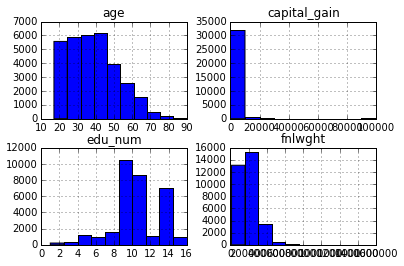

In [14]:
intadults.iloc[:,0:4].hist()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fdbde49e3d0>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7fdbde49e410>]], dtype=object)

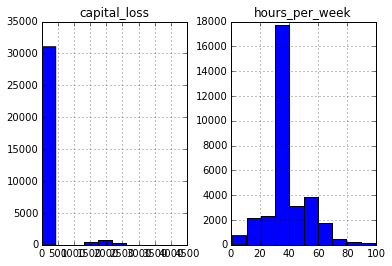

In [15]:
intadults.iloc[:,4:6].hist()

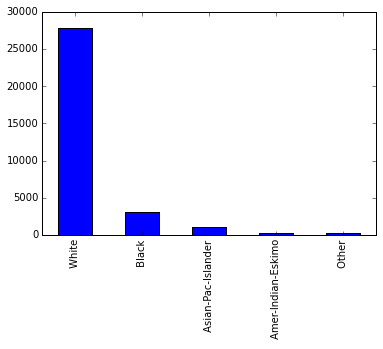

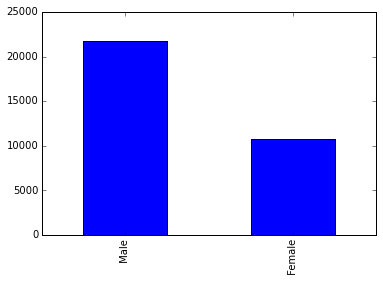

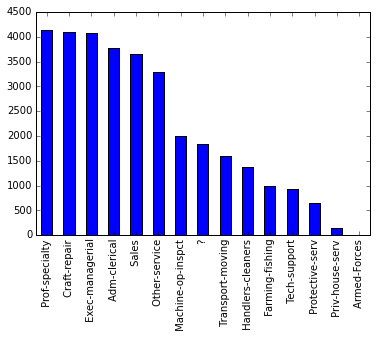

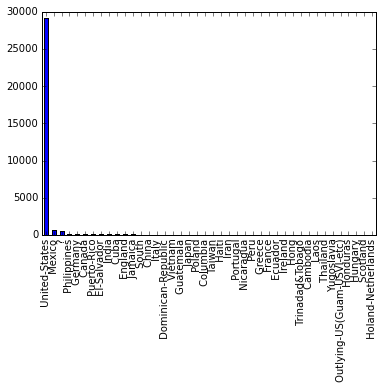

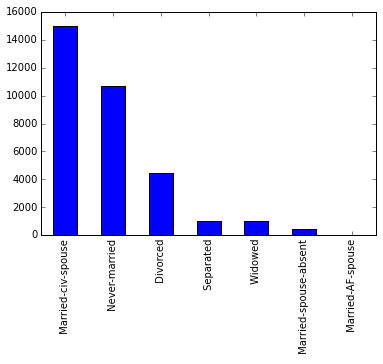

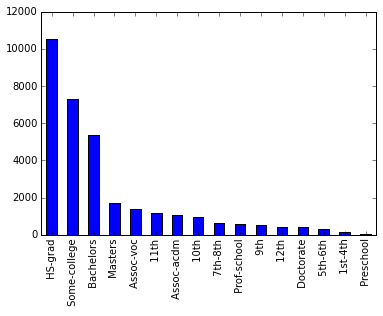

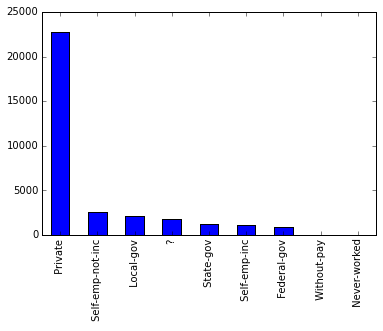

In [16]:
plt.figure(1)
adults['race'].value_counts().plot('bar')
plt.figure(2)
adults['sex'].value_counts().plot('bar' , figure = 2)
plt.figure(3)
adults['occupation'].value_counts().plot('bar')
plt.figure(4)
adults['native_country'].value_counts().plot('bar')
plt.figure(5)
adults['marital_status'].value_counts().plot('bar')
plt.figure(6)
adults['education'].value_counts().plot('bar')
plt.figure(7)
adults['workclass'].value_counts().plot('bar')


In [17]:
less = target.value_counts().iloc[0]
greater = target.value_counts().iloc[1]
def percentify(x):
    

IndentationError: expected an indented block (<ipython-input-17-96424bcc9266>, line 4)

In [2]:
pd.crosstab(adults['sex'] , target).iloc[:,0]

NameError: name 'pd' is not defined

In [1]:
pd.concat((pd.crosstab(adults['sex'] , target).iloc[:,0]/less , pd.crosstab(adults['sex'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'pd' is not defined

In [18]:
pd.crosstab(adults['race'] , target)

target,<=50K,>50K
race,,
Amer-Indian-Eskimo,275,36
Asian-Pac-Islander,763,276
Black,2737,387
Other,246,25
White,20699,7117


In [19]:
pd.concat((pd.crosstab(adults['race'] , target).iloc[:,0]/less , pd.crosstab(adults['race'] , target).iloc[:,1]/greater) , axis = 1)

NameError: name 'less' is not defined

In [20]:
pd.crosstab(adults['occupation'] , target)

target,<=50K,>50K
occupation,,
?,1652,191
Adm-clerical,3263,507
Armed-Forces,8,1
Craft-repair,3170,929
Exec-managerial,2098,1968
Farming-fishing,879,115
Handlers-cleaners,1284,86
Machine-op-inspct,1752,250
Other-service,3158,137


In [21]:
pd.concat((pd.crosstab(adults['occupation'] , target).iloc[:,0]/less , pd.crosstab(adults['occupation'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'less' is not defined

In [22]:
pd.crosstab(adults['marital_status'] , target)

target,<=50K,>50K
marital_status,,
Divorced,3980,463
Married-AF-spouse,13,10
Married-civ-spouse,8284,6692
Married-spouse-absent,384,34
Never-married,10192,491
Separated,959,66
Widowed,908,85


In [23]:
pd.concat((pd.crosstab(adults['marital_status'] , target).iloc[:,0]/less , pd.crosstab(adults['marital_status'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'less' is not defined

In [24]:
pd.crosstab(adults['native_country'] , target)

target,<=50K,>50K
native_country,,
?,437,146
Cambodia,12,7
Canada,82,39
China,55,20
Columbia,57,2
Cuba,70,25
Dominican-Republic,68,2
Ecuador,24,4
El-Salvador,97,9


In [25]:
pd.concat((pd.crosstab(adults['native_country'] , target).iloc[:,0]/less , pd.crosstab(adults['native_country'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'less' is not defined

In [26]:
pd.crosstab(adults['education'] , target)

target,<=50K,>50K
education,,
10th,871,62
11th,1115,60
12th,400,33
1st-4th,162,6
5th-6th,317,16
7th-8th,606,40
9th,487,27
Assoc-acdm,802,265
Assoc-voc,1021,361


In [27]:
pd.concat((pd.crosstab(adults['education'] , target).iloc[:,0]/less , pd.crosstab(adults['education'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'less' is not defined

In [28]:
pd.crosstab(adults['workclass'] , target)

target,<=50K,>50K
workclass,,
?,1645,191
Federal-gov,589,371
Local-gov,1476,617
Never-worked,7,0
Private,17733,4963
Self-emp-inc,494,622
Self-emp-not-inc,1817,724
State-gov,945,353
Without-pay,14,0


In [29]:
pd.concat((pd.crosstab(adults['workclass'] , target).iloc[:,0]/less , pd.crosstab(adults['workclass'] , target).iloc[:,1]/greater) , axis = 1)


NameError: name 'less' is not defined

In [30]:
pd.crosstab([adults['workclass'] , adults['sex'], adults['occupation']] , target) #make a multi dimensional cross table 

target                                    <=50K   >50K
workclass    sex     occupation                       
 ?            Female  ?                     787     52
              Male    ?                     858    139
 Federal-gov  Female  Adm-clerical          117     17
                      Craft-repair            2      2
                      Exec-managerial        54     14
                      Farming-fishing         1      0
                      Handlers-cleaners       4      0
                      Machine-op-inspct       2      0
                      Other-service          14      1
                      Prof-specialty         40     18
                      Protective-serv         3      1
                      Sales                   5      1
                      Tech-support           15      1
                      Transport-moving        2      1
              Male    Adm-clerical           99     84
                      Armed-Forces            8      1
                      Craft-repair           41     19
                      Exec-managerial        34     78
                      Farming-fishing         5      2
                      Handlers-cleaners      17      2
                      Machine-op-inspct      10      2
                      Other-service          18      2
                      Prof-specialty         40     77
                      Protective-serv        11     13
                      Sales                   4      4
                      Tech-support           28     24
                      Transport-moving       15      7
 Local-gov    Female  Adm-clerical          199     19
                      Craft-repair            5      1
                      Exec-managerial        44     15
...                                         ...    ...
 State-gov    Female  Exec-managerial        51     18
                      Handlers-cleaners       1      0
                      Machine-op-inspct       3      0
                      Other-service          61      2
                      Prof-specialty        108     37
                      Protective-serv        12      1
                      Sales                   4      0
                      Tech-support           22      3
                      Transport-moving        2      1
              Male    Adm-clerical           71     21
                      Craft-repair           40     14
                      Exec-managerial        57     63
                      Farming-fishing        13      2
                      Handlers-cleaners       7      1
                      Machine-op-inspct       5      5
                      Other-service          59      2
                      Prof-specialty        135    134
                      Protective-serv        75     28
                      Sales                   4      3
                      Tech-support           26      6
                      Transport-moving       32      6
 Without-pay  Female  Adm-clerical            2      0
                      Farming-fishing         2      0
                      Machine-op-inspct       1      0
              Male    Adm-clerical            1      0
                      Craft-repair            1      0
                      Farming-fishing         4      0
                      Handlers-cleaners       1      0
                      Other-service           1      0
                      Transport-moving        1      0

[154 rows x 2 columns]

In [31]:
adults['sex']

0           Male
1           Male
2           Male
3           Male
4         Female
5         Female
6         Female
7           Male
8         Female
9           Male
10          Male
11          Male
12        Female
13          Male
14          Male
15          Male
16          Male
17          Male
18          Male
19        Female
20          Male
21        Female
22          Male
23          Male
24        Female
25          Male
26          Male
27          Male
28          Male
29          Male
          ...   
32531     Female
32532       Male
32533       Male
32534     Female
32535       Male
32536     Female
32537       Male
32538     Female
32539       Male
32540     Female
32541     Female
32542       Male
32543     Female
32544     Female
32545     Female
32546     Female
32547       Male
32548       Male
32549     Female
32550       Male
32551       Male
32552       Male
32553       Male
32554       Male
32555       Male
32556     Female
32557       Male
32558     Fema

In [32]:
adults.loc[adults['sex'] == ' Female' , 'target']# example using the loc function 
adults['sex'] # every value in the column with index sex
adults.loc[:, 'sex'] # every row in the sex column 
adults.iloc[:,9] # every row in the ninth colum 


0           Male
1           Male
2           Male
3           Male
4         Female
5         Female
6         Female
7           Male
8         Female
9           Male
10          Male
11          Male
12        Female
13          Male
14          Male
15          Male
16          Male
17          Male
18          Male
19        Female
20          Male
21        Female
22          Male
23          Male
24        Female
25          Male
26          Male
27          Male
28          Male
29          Male
          ...   
32531     Female
32532       Male
32533       Male
32534     Female
32535       Male
32536     Female
32537       Male
32538     Female
32539       Male
32540     Female
32541     Female
32542       Male
32543     Female
32544     Female
32545     Female
32546     Female
32547       Male
32548       Male
32549     Female
32550       Male
32551       Male
32552       Male
32553       Male
32554       Male
32555       Male
32556     Female
32557       Male
32558     Fema

In [33]:
adults['sex'][0]

' Male'

In [34]:
#example of ussing the apply and apply map functions
def num(x):
    if x == ' <=50K':
        x = 0
    else:
        x = 1
    return x

In [35]:
targetnum = target.apply(num) # can also use a lambda function here 

In [36]:
y_train = targetnum

In [37]:
m = adults[adults['sex'] == ' Male']

In [38]:
f = adults[adults['sex'] == ' Female']

In [39]:
pd.concat((m,f) , axis = 0) # this works, by combining along the rows and the index's get sorted to the right order because pandas is always
#tracking the index of a dataframe 

,age,workclass,fnlwght,education,edu_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,target
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
7,52,Self-emp-not-inc,209642,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,>50K
9,42,Private,159449,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,5178,0,40,United-States,>50K
10,37,Private,280464,Some-college,10,Married-civ-spouse,Exec-managerial,Husband,Black,Male,0,0,80,United-States,>50K
11,30,State-gov,141297,Bachelors,13,Married-civ-spouse,Prof-specialty,Husband,Asian-Pac-Islander,Male,0,0,40,India,>50K
13,32,Private,205019,Assoc-acdm,12,Never-married,Sales,Not-in-family,Black,Male,0,0,50,United-States,<=50K
14,40,Private,121772,Assoc-voc,11,Married-civ-spouse,Craft-repair,Husband,Asian-Pac-Islander,Male,0,0,40,?,>50K


In [40]:
a = adults['sex'][0:100]
b = adults['sex'][50:150]

In [41]:
pd.merge(adults,adults) # this will leave it unchanged

,age,workclass,fnlwght,education,edu_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,target
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
5,37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K
6,49,Private,160187,9th,5,Married-spouse-absent,Other-service,Not-in-family,Black,Female,0,0,16,Jamaica,<=50K
7,52,Self-emp-not-inc,209642,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,>50K
8,31,Private,45781,Masters,14,Never-married,Prof-specialty,Not-in-family,White,Female,14084,0,50,United-States,>50K
9,42,Private,159449,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,5178,0,40,United-States,>50K


In [42]:
a = adults.iloc[:,0:5]
b = adults.iloc[:,3:7]


In [48]:
from sklearn.naive_bayes import GaussianNB
from sklearn import cross_validation
from sklearn import preprocessing
from sklearn.pipeline import Pipeline


In [44]:
X_train , X_test, y_train, y_test = cross_validation.train_test_split(x_train,y_train)


In [47]:
preprocessing.scale(x_train)

array([[-0.2444502 , -0.17429511, -0.26209736, ...,  0.1484529 ,
        -0.21665953, -0.03542945],
       [-0.2444502 , -0.17429511, -0.26209736, ..., -0.14592048,
        -0.21665953, -2.22215312],
       [-0.2444502 , -0.17429511, -0.26209736, ..., -0.14592048,
        -0.21665953, -0.03542945],
       ..., 
       [-0.2444502 , -0.17429511, -0.26209736, ..., -0.14592048,
        -0.21665953, -0.03542945],
       [-0.2444502 , -0.17429511, -0.26209736, ..., -0.14592048,
        -0.21665953, -1.65522476],
       [-0.2444502 , -0.17429511, -0.26209736, ...,  1.88842434,
        -0.21665953, -0.03542945]])

In [53]:
Estimators = [ ('scale' , preprocessing.scale(x_train)) , ('gnb' , GaussianNB())]

,age,fnlwght,edu_num,capital_gain,capital_loss,hours_per_week
0,39,77516,13,2174,0,40
1,50,83311,13,0,0,13
2,38,215646,9,0,0,40
3,53,234721,7,0,0,40
4,28,338409,13,0,0,40
5,37,284582,14,0,0,40
6,49,160187,5,0,0,16
7,52,209642,9,0,0,45
8,31,45781,14,14084,0,50
9,42,159449,13,5178,0,40
